# Covid-19 India : Data Analysis

***Coronavirus disease 2019 (COVID‑19) is an infectious disease caused by severe acute respiratory syndrome coronavirus 2 (SARS-CoV-2). It was first identified in December 2019 in Wuhan, Hubei, China, and has resulted in an ongoing pandemic. As of 16 September 2020, more than 29.6 million cases have been reported across 188 countries and territories with more than 936,000 deaths; more than 20.1 million people have recovered.***


***The COVID-19 pandemic in India is part of the worldwide pandemic of coronavirus disease 2019 (COVID-19) caused by severe acute respiratory syndrome coronavirus 2 (SARS-CoV-2). The first case of COVID-19 in India, which originated from China, was reported on 30 January 2020. India currently has the largest number of confirmed cases in Asia, and has the second-highest number of confirmed cases in the world after the United States with more than 10.3 million reported cases of COVID-19 infection and more than 150,000 deaths as of January 06, 2021.The per day cases peaked mid-September in India with over 90,000 cases reported per day and have since come down to below 40,000 in December.***


***In July 2020, India's Ministry of Information and Broadcasting claimed the country's case fatality rate was among the lowest in the world at 2.41% and "steadily declining". By mid-May 2020, six cities accounted for around half of all reported cases in the country – Mumbai, Delhi, Ahmedabad, Chennai, Pune and Kolkata. The last region to report its first case was Lakshwadeep, on 19 January 2021, nearly a year after the first reported case in India. On 10 June, India's recoveries exceeded active cases for the first time. Infection rates started to drop significantly in September, and the number of daily new cases and active cases started to decline rapidly. A Government panel on COVID-19 announced in October that the pandemic had peaked in India, and may come under control by February 2021. India has over 30 anti-COVID vaccines in various stages of development and a national vaccination drive was started on 16 January 2021.***

### Importing required libraries 

In [1]:
import pandas as pd
import numpy as np 
import missingno
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import bar_chart_race as bcr
import plotly
import plotly.express as px
import plotly.graph_objects as go
import cufflinks as cf
import plotly.offline as pyo
from plotly.offline import init_notebook_mode,plot,iplot
plt.rcParams['figure.figsize'] = 10, 12
import warnings
warnings.filterwarnings('ignore')

In [2]:
pyo.init_notebook_mode(connected=True)  # Required to use plotly offline in jupyter notebook
cf.go_offline()

### Loading the Dataset 

In [3]:
df = pd.read_csv("covid_19_india.csv")
df.head()

,Sno,Date,Time,State/UnionTerritory,ConfirmedIndianNational,ConfirmedForeignNational,Cured,Deaths,Confirmed
0,1,2020-01-30,6:00 PM,Kerala,1,0,0,0,1
1,2,2020-01-31,6:00 PM,Kerala,1,0,0,0,1
2,3,2020-02-01,6:00 PM,Kerala,2,0,0,0,2
3,4,2020-02-02,6:00 PM,Kerala,3,0,0,0,3
4,5,2020-02-03,6:00 PM,Kerala,3,0,0,0,3


### Checking basic information about the dataset

In [4]:
# using info() function 
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14654 entries, 0 to 14653
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Sno                       14654 non-null  int64 
 1   Date                      14654 non-null  object
 2   Time                      14654 non-null  object
 3   State/UnionTerritory      14654 non-null  object
 4   ConfirmedIndianNational   14654 non-null  object
 5   ConfirmedForeignNational  14654 non-null  object
 6   Cured                     14654 non-null  int64 
 7   Deaths                    14654 non-null  int64 
 8   Confirmed                 14654 non-null  int64 
dtypes: int64(4), object(5)
memory usage: 1.0+ MB


***In above data Summary we can see that there are total 14654 rows and 9 columns in the dataset. The summary also include the list of columns with their Datatypes( Date column has dtype "object" which needs to be converted into "DateTime" format for the analysis) and the number of non-null values in each column. we also have the value of rangeindex provided for the index axis.*** 

### Lets have a look on missing values 

<AxesSubplot:>

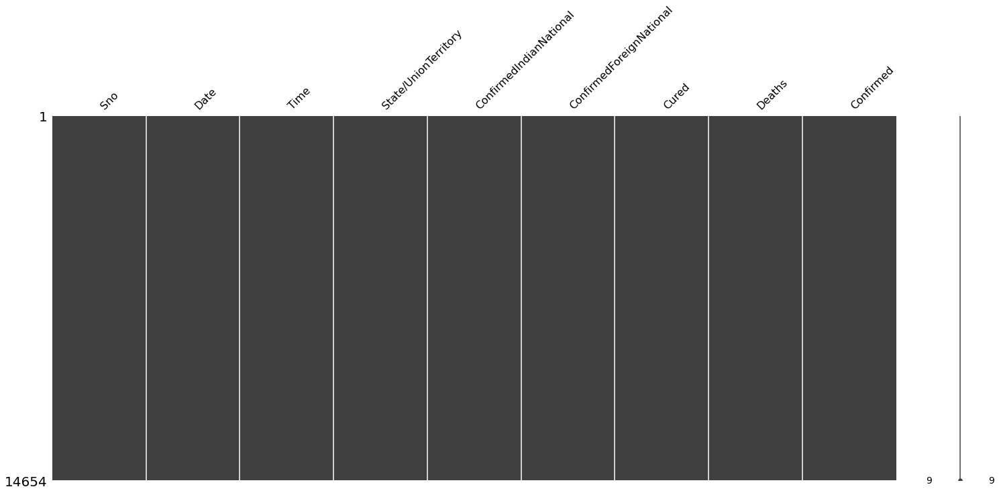

In [5]:
# Exploring the missing values in the dataset using missingno package
missingno.matrix(df)

***According to above visualisation there is no missing values present in the dataset but the dtype of columns "confirmedIndianNational" and "confirmedForeignNational" is not is the proper format so there is a chances of getting misinformation about the data but as I am not going to use these two for the analysis so will gonna drop this.***

### Data Pre-processing

In [6]:
# First lets create a copy of dataframe to avoid any changes in the orignal dataset.
covid19_df = df.copy()

In [7]:
# dropping the columns which I don't need for the analysis 
covid19_df.drop(["Sno","Time","ConfirmedIndianNational","ConfirmedForeignNational"],axis=1,inplace=True)

 *In our data summary table we have seen that the datatype of "Date" column is of object type. so we need to convert into a proper format i.e Datetime dataype.*

In [8]:
# coverting into datetimeformat
covid19_df['Date'] = pd.to_datetime(covid19_df['Date'])
#lets check the format now 
print(covid19_df['Date'].dtypes)    

datetime64[ns]


In [9]:
# Renaming some columns for better understanding 
covid19_df.columns = ['Date', 'States/Union Territory','Recovered_Cases','Deaths','Confirmed_Cases'] 
covid19_df.head()

,Date,States/Union Territory,Recovered_Cases,Deaths,Confirmed_Cases
0,2020-01-30,Kerala,0,0,1
1,2020-01-31,Kerala,0,0,1
2,2020-02-01,Kerala,0,0,2
3,2020-02-02,Kerala,0,0,3
4,2020-02-03,Kerala,0,0,3


#### Now lets take a look at distinct states in the dataset for the further analysis 

In [10]:
covid19_df['States/Union Territory'].unique()

array(['Kerala', 'Telengana', 'Delhi', 'Rajasthan', 'Uttar Pradesh',
       'Haryana', 'Ladakh', 'Tamil Nadu', 'Karnataka', 'Maharashtra',
       'Punjab', 'Jammu and Kashmir', 'Andhra Pradesh', 'Uttarakhand',
       'Odisha', 'Puducherry', 'West Bengal', 'Chhattisgarh',
       'Chandigarh', 'Gujarat', 'Himachal Pradesh', 'Madhya Pradesh',
       'Bihar', 'Manipur', 'Mizoram', 'Andaman and Nicobar Islands',
       'Goa', 'Unassigned', 'Assam', 'Jharkhand', 'Arunachal Pradesh',
       'Tripura', 'Nagaland', 'Meghalaya',
       'Dadra and Nagar Haveli and Daman and Diu',
       'Cases being reassigned to states', 'Sikkim', 'Daman & Diu',
       'Lakshadweep', 'Telangana'], dtype=object)

***There are some rows where the 'States' is not defined properly. So, we are not considering those states for our analysis and thus removing them. Also there is some reduntant state so will drop them.***

In [11]:
covid_data = covid19_df[(covid19_df['States/Union Territory'] != 'Unassigned') &
                    (covid19_df['States/Union Territory'] != 'Cases being reassigned to states')]
covid_data.drop(covid_data[covid_data['States/Union Territory'] == 'Telengana'].index,inplace = True)
covid_data['States/Union Territory'].unique()

array(['Kerala', 'Delhi', 'Rajasthan', 'Uttar Pradesh', 'Haryana',
       'Ladakh', 'Tamil Nadu', 'Karnataka', 'Maharashtra', 'Punjab',
       'Jammu and Kashmir', 'Andhra Pradesh', 'Uttarakhand', 'Odisha',
       'Puducherry', 'West Bengal', 'Chhattisgarh', 'Chandigarh',
       'Gujarat', 'Himachal Pradesh', 'Madhya Pradesh', 'Bihar',
       'Manipur', 'Mizoram', 'Andaman and Nicobar Islands', 'Goa',
       'Assam', 'Jharkhand', 'Arunachal Pradesh', 'Tripura', 'Nagaland',
       'Meghalaya', 'Dadra and Nagar Haveli and Daman and Diu', 'Sikkim',
       'Daman & Diu', 'Lakshadweep', 'Telangana'], dtype=object)

### Let's check the total number of confirmed cases, deaths and Recovered cases in india 

In [12]:
confirmed = covid_data['Confirmed_Cases'].sum()
recovered = covid_data['Recovered_Cases'].sum()
deaths = covid_data['Deaths'].sum()

In [13]:
print("Total Confirmed Cases =" ,confirmed)
print("Total Recovered Cases =" ,recovered)
print("Total Deaths =" ,deaths)

Total Confirmed Cases = 2574919243
Total Recovered Cases = 2333142234
Total Deaths = 37525434


In [14]:
names = ['Confirmed Cases','Recovered Cases','Deaths']
values = [confirmed , recovered, deaths]

fig = px.pie(values=values, names=names,color_discrete_sequence=px.colors.sequential.RdBu,template='plotly_dark')
fig.show("notebook")

### State Report with Recovery Rate and Death Rate

In [15]:
state_report = covid_data.groupby(by = 'States/Union Territory').max().reset_index()

state_report['Active'] = (state_report['Confirmed_Cases'] - (state_report['Recovered_Cases'] + state_report['Deaths']))
state_report["Deaths (per 100 cases)"] = round(((state_report['Deaths']/state_report['Confirmed_Cases'])*100),2)
state_report["Recovery Rate(per 100 cases)"] = round(((state_report["Recovered_Cases"]/state_report["Confirmed_Cases"])*100),2)

state_report.drop(columns = ['Date'],inplace = True)

state_report.style.background_gradient(cmap = 'Greens',subset= ['Recovered_Cases'])\
                    .background_gradient(cmap = 'Reds',subset= ['Deaths'])\
                    .background_gradient(cmap = 'Blues',subset= ['Confirmed_Cases'])\
                    .background_gradient(cmap = 'Purples',subset= ['Active'])\
                    .background_gradient(cmap = 'Greys',subset = ["Deaths (per 100 cases)"]).format('{:.2f}', subset = ['Deaths (per 100 cases)'])\
                    .background_gradient(cmap = 'RdBu',subset = ["Recovery Rate(per 100 cases)"]).format('{:.2f}', subset = ['Recovery Rate(per 100 cases)'])


,States/Union Territory,Recovered_Cases,Deaths,Confirmed_Cases,Active,Deaths (per 100 cases),Recovery Rate(per 100 cases)
0,Andaman and Nicobar Islands,5958,72,6255,225,1.15,95.25
1,Andhra Pradesh,1037411,8446,1228186,182329,0.69,84.47
2,Arunachal Pradesh,17717,59,19634,1858,0.30,90.24
3,Assam,242980,1531,277687,33176,0.55,87.50
4,Bihar,435574,3077,553803,115152,0.56,78.65
5,Chandigarh,38591,541,47552,8420,1.14,81.16
6,Chhattisgarh,675294,9950,816489,131245,1.22,82.71
7,Dadra and Nagar Haveli and Daman and Diu,6917,4,8502,1581,0.05,81.36
8,Daman & Diu,0,0,2,2,0.00,0.00
9,Delhi,1164008,18398,1273035,90629,1.45,91.44


### India's Top 15 States with Highest Number of Cases

In [16]:
temp = state_report.sort_values(by = 'Confirmed_Cases',ascending= False)[0:15]
temp.reset_index(inplace = True,drop = True)

temp.sort_values(by = 'Confirmed_Cases',ascending = False)

plt.figure(figsize= (20,15))
fig2 = px.bar(data_frame=temp, x = temp['States/Union Territory'], y=temp['Confirmed_Cases'],
            color_continuous_scale= px.colors.sequential.Blues, color = 'Confirmed_Cases',
            text='Confirmed_Cases',template = 'plotly_dark',
            labels = {'States/Union Territory':'State','Confirmed_Cases':'Confirmed Cases '},
            hover_name = 'States/Union Territory',
            hover_data = {'Confirmed_Cases':True,'States/Union Territory':False}, )

fig2.update_layout(title = {
    'text' : "India's Top 15 States by Confirmed Cases",
    'y':0.95,
    'x':0.5,
    'xanchor': 'center',
    'yanchor': 'top'},        
    xaxis_title = '')

fig2.update_traces(texttemplate = '%{text:.2s}',textposition = 'outside',textfont_size =13)

fig2.show()

<Figure size 1440x1080 with 0 Axes>

### India's Top 15 States with Recovery per 100 Cases

In [17]:

state_recovery = state_report.sort_values(by="Recovered_Cases",ascending = False)[0:15]

plt.figure(figsize = (12,8),dpi = 150)

fig1 = px.bar(x = state_recovery['States/Union Territory'],y = state_recovery['Recovered_Cases'],orientation='v',
       labels = {'x':'Recovered_Cases','y':'States or Union Territory','States/Union Territory':'States','Recovery Rate(per 100 cases)':'Recovery Rate per 100 Cases '},
       color = state_recovery['Recovery Rate(per 100 cases)'], color_continuous_scale = px.colors.sequential.Greens,
       hover_name = 'States/Union Territory', hover_data = {'Recovered_Cases':True,'Recovery Rate(per 100 cases)':True,'States/Union Territory':False}, 
       data_frame = state_recovery,template = 'plotly_dark', text = state_recovery['Recovery Rate(per 100 cases)'],
       title = "India's Top 15 States with Recovery per 100 Cases")

fig1.update_layout(title = {'x':0.5})
fig1.update_traces(textposition = 'outside')
fig1.show()

<Figure size 1800x1200 with 0 Axes>

### Indias's Top 15 States with Deaths per 100 Cases

In [18]:
state_deaths = state_report.sort_values(by="Deaths",ascending = False)[0:15]

plt.figure(figsize = (12,8),dpi = 150)

fig1 = px.bar(x = state_deaths['States/Union Territory'],y = state_deaths['Deaths'],orientation='v',
       labels = {'x':'Deaths','y':'States or Union Territory','States/Union Territory':'State','Deaths (per 100 cases)':'Deaths per 100 Cases '},
       color = state_deaths['Deaths (per 100 cases)'], color_continuous_scale = px.colors.sequential.Reds,
       hover_name = 'States/Union Territory', hover_data = {'Deaths':True,'Deaths (per 100 cases)':True,'States/Union Territory':False}, 
       data_frame = state_deaths,template = 'plotly_dark', text = state_deaths['Deaths (per 100 cases)'],
       title = "India's Deadliest States with Deaths per 100 Cases")

fig1.update_layout(title = {'x':0.5})
fig1.update_traces(textposition = 'outside')
fig1.show()

<Figure size 1800x1200 with 0 Axes>

### Map Visualisation 

### Total Number of Confirmed Cases in Each State

In [19]:
fig = px.choropleth(state_report.sort_values('Confirmed_Cases',ascending=False), geojson="https://gist.githubusercontent.com/jbrobst/56c13bbbf9d97d187fea01ca62ea5112/raw/e388c4cae20aa53cb5090210a42ebb9b765c0a36/india_states.geojson", color="Confirmed_Cases",
                    locations="States/Union Territory",locationmode='geojson-id', featureidkey="properties.ST_NM",
                    hover_data=["Confirmed_Cases"],
                    color_continuous_scale='BuPu',
                    title='Total Number of Confirmed Cases in Each State',
                    template = 'plotly_dark'
                   )
fig.update_geos(fitbounds="locations", visible=False)
fig.update_geos(projection_type="orthographic")
fig.update_layout(height=500,margin={"r":0,"t":30,"l":0,"b":30},title={'x':0.5})
fig.show()

### Total Number of Active Cases in Each State

In [20]:
fig = px.choropleth(state_report.sort_values('Active',ascending=False), geojson="https://gist.githubusercontent.com/jbrobst/56c13bbbf9d97d187fea01ca62ea5112/raw/e388c4cae20aa53cb5090210a42ebb9b765c0a36/india_states.geojson", color="Active",
                    locations="States/Union Territory",locationmode='geojson-id', featureidkey="properties.ST_NM",
                    hover_data=["Active"],
                    color_continuous_scale='solar',
                    title='Total Number of Active Cases in each State',
                    template = 'plotly_dark'
                   )
fig.update_geos(fitbounds="locations", visible=False)
fig.update_geos(projection_type="orthographic")
fig.update_layout(height=500,margin={"r":0,"t":30,"l":0,"b":30},title={'x':0.5})
fig.show()

### Total Number of Recovered Cases in Each State

In [21]:
fig = px.choropleth(state_report.sort_values('Recovered_Cases',ascending=False), geojson="https://gist.githubusercontent.com/jbrobst/56c13bbbf9d97d187fea01ca62ea5112/raw/e388c4cae20aa53cb5090210a42ebb9b765c0a36/india_states.geojson", color="Recovered_Cases",
                    locations="States/Union Territory",locationmode='geojson-id', featureidkey="properties.ST_NM",
                    hover_data=["Recovered_Cases"],
                    color_continuous_scale='Greens',
                    title='Total Number of Recovered Cases in Each State',
                    template = 'plotly_dark'
                   )
fig.update_geos(fitbounds="locations", visible=False)
fig.update_geos(projection_type="orthographic")
fig.update_layout(height=500,margin={"r":0,"t":30,"l":0,"b":30},title={'x':0.5})
fig.show()

### Total Number of Deaths in Each State

In [22]:
fig = px.choropleth(state_report.sort_values('Deaths',ascending=False), geojson="https://gist.githubusercontent.com/jbrobst/56c13bbbf9d97d187fea01ca62ea5112/raw/e388c4cae20aa53cb5090210a42ebb9b765c0a36/india_states.geojson", color="Deaths",
                    locations="States/Union Territory",locationmode='geojson-id', featureidkey="properties.ST_NM",
                    hover_data=["Deaths"],
                    color_continuous_scale='Reds',
                    title='Total Number of Deaths in Each State',
                    template = 'plotly_dark'
                   )
fig.update_geos(fitbounds="locations", visible=False)
fig.update_geos(projection_type="orthographic")
fig.update_layout(height=500,margin={"r":0,"t":30,"l":0,"b":30},title={'x':0.5})
fig.show()

### Fatality-Ratio 

In [23]:
covid_data['Fatality Ratio'] = covid_data['Deaths']/covid_data['Confirmed_Cases']

In [24]:
covid_data['Fatality Ratio']

0        0.000000
1        0.000000
2        0.000000
3        0.000000
4        0.000000
           ...   
14649    0.005450
14650    0.010964
14651    0.014944
14652    0.010170
14653    0.012795
Name: Fatality Ratio, Length: 14165, dtype: float64

### Fatality-Ratio in different States 

In [25]:
fatality_ratio=covid_data.groupby('States/Union Territory')['Fatality Ratio'].sum().reset_index()
fatality_ratio.iplot(kind='line',mode='lines+markers',x='States/Union Territory',y='Fatality Ratio',title='Fatality Ratio in different States',color='Red',theme='solar')

### Fatality-Ratio Over Time

In [26]:
fatality_year=covid_data.groupby('Date')['Fatality Ratio'].sum().reset_index()
fatality_year.iplot(kind='line',x='Date',y='Fatality Ratio',title='Fatality-Ratio Over Time',color='Red',theme='solar')

### Cure-Ratio in Different States

In [27]:
covid_data['Cure-Ratio'] = covid_data['Recovered_Cases']/covid_data['Confirmed_Cases']

In [28]:
covid_data['Cure-Ratio']

0        0.000000
1        0.000000
2        0.000000
3        0.000000
4        0.000000
           ...   
14649    0.841218
14650    0.926837
14651    0.699552
14652    0.807601
14653    0.855905
Name: Cure-Ratio, Length: 14165, dtype: float64

In [29]:
cure_ratio=covid_data.groupby('States/Union Territory')['Cure-Ratio'].sum().reset_index()
cure_ratio.iplot(kind='line',mode='lines+markers',x='States/Union Territory',y='Cure-Ratio',title='Cure-Ratio in different States',color='Green',theme='solar')

### Cure-Ratio Over time

In [30]:
fatality_year=covid_data.groupby('Date')['Cure-Ratio'].sum().reset_index()
fatality_year.iplot(kind='line',x='Date',y='Cure-Ratio',title='Cure-Ratio Over Time',color='Green',theme='solar')

### Time Series Analysis
### Covid-19 Rise of Confirmed Cases Datewise 

In [31]:
# arranging the dataframes for creating a bar chart race 
# set countries and date as index and find cases
# transpose the dataframe to have countries as columns and dates as rows

covid_df_by_date = covid_data.set_index(['States/Union Territory','Date']).unstack()['Confirmed_Cases'].T.reset_index()

covid_df_by_date = covid_df_by_date.set_index('Date') #make date as index - desired by barchartrace

covid_df_by_date = covid_df_by_date.fillna(0) #fill na with 0

covid_df_by_date.sample(5) 

States/Union Territory,Andaman and Nicobar Islands,Andhra Pradesh,Arunachal Pradesh,Assam,Bihar,Chandigarh,Chhattisgarh,Dadra and Nagar Haveli and Daman and Diu,Daman & Diu,Delhi,...,Puducherry,Punjab,Rajasthan,Sikkim,Tamil Nadu,Telangana,Tripura,Uttar Pradesh,Uttarakhand,West Bengal
Date,,,,,,,,,,,,,,,,,,,,,
2020-05-21,33.0,2602.0,1.0,170.0,1674.0,202.0,115.0,1.0,0.0,11088.0,...,18.0,2005.0,6015.0,0.0,13191.0,0.0,173.0,5175.0,122.0,3103.0
2020-04-22,17.0,813.0,1.0,35.0,126.0,27.0,36.0,0.0,0.0,2156.0,...,7.0,251.0,1801.0,0.0,1596.0,0.0,2.0,1412.0,46.0,423.0
2020-04-01,10.0,83.0,0.0,1.0,23.0,16.0,9.0,0.0,0.0,152.0,...,3.0,42.0,93.0,0.0,234.0,0.0,0.0,103.0,7.0,37.0
2020-09-08,3359.0,506493.0,5180.0,128244.0,149027.0,5995.0,47280.0,2590.0,0.0,193526.0,...,17316.0,65583.0,92536.0,1939.0,469256.0,0.0,16135.0,271851.0,25436.0,183865.0
2021-02-20,5014.0,889156.0,16836.0,217367.0,262009.0,21371.0,310469.0,3402.0,0.0,637603.0,...,39540.0,177759.0,319363.0,6127.0,847385.0,0.0,33392.0,602592.0,97031.0,573387.0


In [32]:
df = covid_df_by_date
bcr.bar_chart_race(
    df=df,
    #filename='covid-19_cases_in_india.mp4',
    orientation='h',
    sort='desc',
    n_bars=10,
    fixed_order=False,
    fixed_max=True,
    steps_per_period=10,
    interpolate_period=False,
    label_bars=True,
    bar_size=.95,
    period_label={'x': .99, 'y': .25, 'ha': 'right', 'va': 'center'},
    period_fmt='%B %d, %Y',
    period_summary_func=lambda v, r: {'x': .99, 'y': .18,
                                      's': f'Total Confirmed Cases: {v.nlargest(6).sum():,.0f}',
                                      'ha': 'right', 'size': 8, 'family': 'Courier New'},
    period_length=500,
    figsize=(5, 3),
    dpi=144,
    cmap='Dark2',
    title='COVID-19 Confirmed Cases in India',
    title_size='10',
    bar_label_size=7,
    tick_label_size=7,
    shared_fontdict={'family' : 'Helvetica', 'color' : '.1'},
    scale='linear',
    writer=None,
    fig=None,
    bar_kwargs={'alpha': .7},
    filter_column_colors=False)  


findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


### Covid-19 Number of Recovered Cases in India Datewise

In [33]:
# arranging the dataframes for creating a bar chart race 
# set countries and date as index and find cases
# transpose the dataframe to have countries as columns and dates as rows

covid_recovery_by_date = covid_data.set_index(['States/Union Territory','Date']).unstack()['Recovered_Cases'].T.reset_index()

covid_recovery_by_date = covid_recovery_by_date.set_index('Date') #make date as index - desired by barchartrace

covid_recovery_by_date = covid_recovery_by_date.fillna(0) #fill na with 0

covid_recovery_by_date.sample(5) 

States/Union Territory,Andaman and Nicobar Islands,Andhra Pradesh,Arunachal Pradesh,Assam,Bihar,Chandigarh,Chhattisgarh,Dadra and Nagar Haveli and Daman and Diu,Daman & Diu,Delhi,...,Puducherry,Punjab,Rajasthan,Sikkim,Tamil Nadu,Telangana,Tripura,Uttar Pradesh,Uttarakhand,West Bengal
Date,,,,,,,,,,,,,,,,,,,,,
2021-05-07,5958.0,1037411.0,17717.0,242980.0,435574.0,38591.0,675294.0,6917.0,0.0,1164008.0,...,53296.0,339803.0,499376.0,6769.0,1151058.0,405164.0,34153.0,1151571.0,154147.0,800328.0
2020-11-16,4330.0,828484.0,14500.0,205639.0,219263.0,14468.0,188869.0,3267.0,0.0,437801.0,...,34732.0,131431.0,205414.0,4125.0,730272.0,0.0,30555.0,480965.0,62543.0,394576.0
2021-01-06,4856.0,873427.0,16609.0,212249.0,247929.0,19464.0,271988.0,3370.0,0.0,612527.0,...,37292.0,159265.0,300126.0,5316.0,802385.0,0.0,32835.0,568892.0,87105.0,537250.0
2021-01-15,4891.0,876140.0,16674.0,212706.0,251278.0,19835.0,281136.0,3377.0,0.0,617930.0,...,37629.0,161710.0,305953.0,5719.0,810218.0,0.0,32890.0,576519.0,90218.0,546193.0
2020-10-08,3696.0,678828.0,8396.0,157638.0,179732.0,11190.0,103828.0,3010.0,0.0,270305.0,...,24930.0,105585.0,127526.0,2615.0,580736.0,0.0,23066.0,374972.0,43904.0,246767.0


In [34]:
df = covid_recovery_by_date
bcr.bar_chart_race(
    df=df,
    #filename='covid-19_recovered_cases_india.mp4',
    orientation='h',
    sort='desc',
    n_bars=10,
    fixed_order=False,
    fixed_max=True,
    steps_per_period=10,
    interpolate_period=False,
    label_bars=True,
    bar_size=.95,
    period_label={'x': .99, 'y': .25, 'ha': 'right', 'va': 'center'},
    period_fmt='%B %d, %Y',
    period_summary_func=lambda v, r: {'x': .99, 'y': .18,
                                      's': f'Total Recovered Cases: {v.nlargest(6).sum():,.0f}',
                                      'ha': 'right', 'size': 8, 'family': 'Courier New'},
    period_length=500,
    figsize=(5, 3),
    dpi=144,
    cmap='summer',
    title='COVID-19 Recovered Cases in India',
    title_size='10',
    bar_label_size=7,
    tick_label_size=7,
    shared_fontdict={'family' : 'Helvetica', 'color' : '.1'},
    scale='linear',
    writer=None,
    fig=None,
    bar_kwargs={'alpha': .7},
    filter_column_colors=False) 

### Covid-19 Number of Deaths in India Datewise

In [35]:
# arranging the dataframes for creating a bar chart race 
# set countries and date as index and find cases
# transpose the dataframe to have countries as columns and dates as rows

covid_death_by_date = covid_data.set_index(['States/Union Territory','Date']).unstack()['Deaths'].T.reset_index()

covid_death_by_date = covid_death_by_date.set_index('Date') #make date as index - desired by barchartrace

covid_death_by_date = covid_death_by_date.fillna(0) #fill na with 0

covid_death_by_date.sample(5) 

States/Union Territory,Andaman and Nicobar Islands,Andhra Pradesh,Arunachal Pradesh,Assam,Bihar,Chandigarh,Chhattisgarh,Dadra and Nagar Haveli and Daman and Diu,Daman & Diu,Delhi,...,Puducherry,Punjab,Rajasthan,Sikkim,Tamil Nadu,Telangana,Tripura,Uttar Pradesh,Uttarakhand,West Bengal
Date,,,,,,,,,,,,,,,,,,,,,
2020-06-26,0.0,136.0,1.0,9.0,57.0,6.0,12.0,0.0,0.0,2429.0,...,9.0,120.0,379.0,0.0,911.0,0.0,1.0,611.0,36.0,606.0
2020-03-11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2020-08-14,22.0,2378.0,4.0,169.0,426.0,27.0,114.0,2.0,0.0,4167.0,...,102.0,706.0,833.0,1.0,5397.0,0.0,46.0,2280.0,143.0,2259.0
2021-02-25,62.0,7168.0,56.0,1091.0,1538.0,351.0,3813.0,2.0,0.0,10905.0,...,666.0,5786.0,2785.0,135.0,12478.0,0.0,391.0,8721.0,1690.0,10256.0
2021-04-19,64.0,7410.0,56.0,1135.0,1749.0,413.0,5908.0,4.0,0.0,12121.0,...,708.0,7902.0,3151.0,136.0,13113.0,0.0,394.0,9830.0,1868.0,10568.0


In [36]:
df = covid_death_by_date
bcr.bar_chart_race(
    df=df,
    #filename='covid-19_deaths_in_india.mp4',
    orientation='h',
    sort='desc',
    n_bars=10,
    fixed_order=False,
    fixed_max=True,
    steps_per_period=10,
    interpolate_period=False,
    label_bars=True,
    bar_size=.95,
    period_label={'x': .99, 'y': .25, 'ha': 'right', 'va': 'center'},
    period_fmt='%B %d, %Y',
    period_summary_func=lambda v, r: {'x': .99, 'y': .18,
                                      's': f'Total Deaths: {v.nlargest(6).sum():,.0f}',
                                      'ha': 'right', 'size': 8, 'family': 'Courier New'},
    period_length=500,
    figsize=(5, 3),
    dpi=144,
    cmap='RdBu',
    title='COVID-19 Deaths in India',
    title_size='10',
    bar_label_size=7,
    tick_label_size=7,
    shared_fontdict={'family' : 'Helvetica', 'color' : '.1'},
    scale='linear',
    writer=None,
    fig=None,
    bar_kwargs={'alpha': .7},
    filter_column_colors=False) 

### Let's Have a look on Testing Details

In [37]:
testing_df = pd.read_csv("StatewiseTestingDetails.csv")
testing_df.sample(5)

,Date,State,TotalSamples,Negative,Positive
4773,2020-12-04,Himachal Pradesh,558531.0,513862,NaN
5316,2021-04-21,Jammu and Kashmir,6877256.0,6725084,NaN
11394,2021-02-19,Tamil Nadu,17019551.0,NaN,NaN
13058,2020-06-08,West Bengal,280098.0,NaN,8613.0
6454,2021-01-29,Kerala,9518036.0,NaN,917632.0


### Top 15 States with Total Sample Collections

In [38]:
# States with Total Sample collections
sample_df=testing_df.groupby('State')['TotalSamples'].sum().sort_values(ascending=False).reset_index()

In [39]:
sample_df.head(15).iplot(kind='bar',x='State',y='TotalSamples',theme='solar',color='Olive',title='Top 15 States with Total Sample Collections')

### Top 15 States with Postivie Cases

In [40]:
positive_df=testing_df.groupby('State')['Positive'].sum().sort_values(ascending=False).reset_index()
positive_df.head(15).iplot(kind='bar',x='State',y='Positive',theme='solar',color='Red',title='Top 15 States with Positive Cases')

### COVID Tests Done vs Positive Cases for Every 1000 tests

In [41]:
latest_tests = testing_df.groupby('State',sort=False).sum().sort_values('TotalSamples',ascending = False)[0:20]

latest_tests['Ratio'] = round((latest_tests['Positive']/latest_tests['TotalSamples'])*1000,2)

fig = px.bar(data_frame = latest_tests,
             y  = latest_tests['TotalSamples'],x =  latest_tests['TotalSamples'].index,template = 'plotly_dark',text = latest_tests['Ratio'],
             color = latest_tests['Ratio'],color_continuous_scale= px.colors.sequential.Blugrn,
             labels = {'TotalSamples':'Number of COVID Tests Done',"Ratio":'Positive Cases for every 1000 tests'},
             hover_name = latest_tests['TotalSamples'].index
             )

fig.update_layout(title = {
    'text': 'COVID Tests Done vs Positive Cases for Every 1000 tests'
})
fig.update_traces(textposition = 'outside',textfont_size = 13)

### Now Let's have a look on vaccination dataset 

### Loading the dataset 

In [42]:
vaccine_df = pd.read_csv("covid_vaccine_statewise.csv")
vaccine_df.sample(5)

,Updated On,State,Total Individuals Vaccinated,Total Sessions Conducted,Total Sites,First Dose Administered,Second Dose Administered,Male(Individuals Vaccinated),Female(Individuals Vaccinated),Transgender(Individuals Vaccinated),Total Covaxin Administered,Total CoviShield Administered,AEFI,18-30 years (Age),30-45 years (Age),45-60 years (Age),60+ years (Age),Total Doses Administered
51,08/03/2021,India,16976138.0,923939.0,64854.0,16976138.0,4062362.0,9298005.0,7676312.0,1821.0,1495593.0,15480545.0,NaN,NaN,NaN,NaN,NaN,21038500.0
1109,31/03/2021,Delhi,1034327.0,61050.0,445.0,1034327.0,259730.0,639330.0,394788.0,209.0,304874.0,989183.0,663.0,48532.0,228817.0,303641.0,453187.0,1294057.0
1294,14/02/2021,Gujarat,761549.0,19118.0,4138.0,761549.0,6.0,430105.0,331397.0,47.0,214455.0,547094.0,NaN,NaN,NaN,NaN,NaN,761555.0
877,29/03/2021,Chhattisgarh,1503420.0,53610.0,392.0,1503420.0,305033.0,735406.0,767893.0,121.0,8415.0,1800038.0,462.0,38195.0,277099.0,443368.0,744446.0,1808453.0
3324,30/04/2021,Punjab,2968888.0,441977.0,3459.0,2968888.0,425192.0,1681026.0,1287553.0,309.0,290847.0,3103233.0,NaN,NaN,NaN,NaN,NaN,3394080.0


### Let's look at the basic information about the data.

In [43]:
# using info() function 
vaccine_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4255 entries, 0 to 4254
Data columns (total 18 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   Updated On                           4255 non-null   object 
 1   State                                4255 non-null   object 
 2   Total Individuals Vaccinated         4207 non-null   float64
 3   Total Sessions Conducted             4207 non-null   float64
 4   Total Sites                          4207 non-null   float64
 5   First Dose Administered              4207 non-null   float64
 6   Second Dose Administered             4207 non-null   float64
 7   Male(Individuals Vaccinated)         4207 non-null   float64
 8   Female(Individuals Vaccinated)       4207 non-null   float64
 9   Transgender(Individuals Vaccinated)  4207 non-null   float64
 10  Total Covaxin Administered           4207 non-null   float64
 11  Total CoviShield Administered 

***In above data Summary we can see that there are total 4255 rows and 18 columns in the dataset. The summary also include the list of columns with their Datatypes( Date column has dtype "object" which needs to be converted into "DateTime" format for the analysis) and the number of non-null values in each column. we also have the value of rangeindex provided for the index axis.***

### Checking Missing Values

In [44]:
# checking total number of Missing values column wise.
vaccine_df.isnull().sum()

Updated On                                0
State                                     0
Total Individuals Vaccinated             48
Total Sessions Conducted                 48
Total Sites                              48
First Dose Administered                  48
Second Dose Administered                 48
Male(Individuals Vaccinated)             48
Female(Individuals Vaccinated)           48
Transgender(Individuals Vaccinated)      48
Total Covaxin Administered               48
Total CoviShield Administered            48
AEFI                                   2305
18-30 years (Age)                      2305
30-45 years (Age)                      2305
45-60 years (Age)                      2305
60+ years (Age)                        2305
Total Doses Administered                  1
dtype: int64

In [45]:
# total number of Missing values in entire dataset.
vaccine_df.isnull().sum().sum()

12006

<AxesSubplot:>

findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


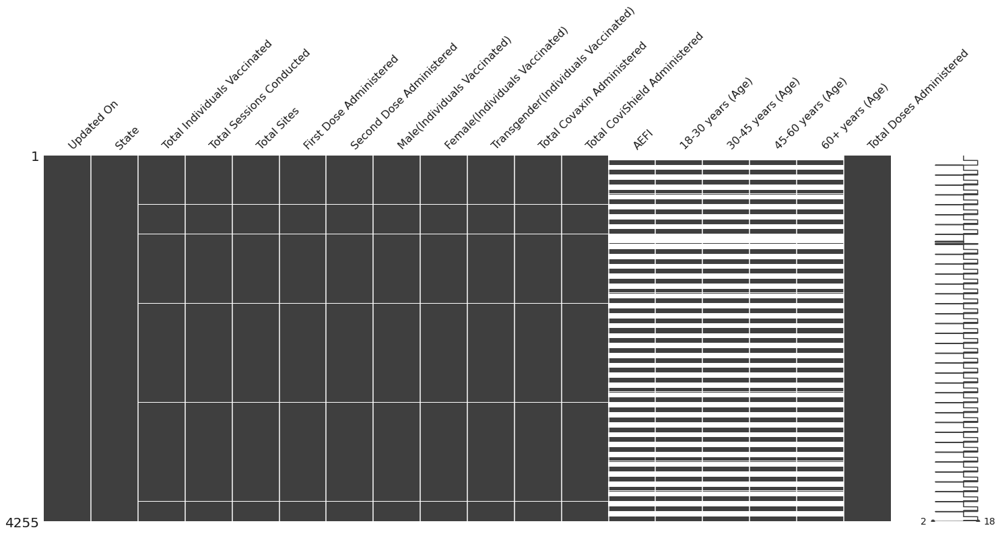

In [46]:
# visual representation of missing values with the help of missingno library
missingno.matrix(vaccine_df)

***So we can clearly see that there are quite a lot of missing values present in the entire dataset and specially the few columns like(AEFI and age columns) contains almost 50% of the missing values. So before diving into EDA we need to deal with these missing values and also drop some columns which we don't need for further analysis.***


### Data Pre-processing


In [47]:
# First lets create a copy of dataframe to avoid any changes in the orignal dataset.
vaccine_data = vaccine_df.copy()

In [48]:
# dropping the columns with alomost 50% missing values which contain I don't need for the analysis 
vaccine_data.drop(["AEFI","18-30 years (Age)","30-45 years (Age)","45-60 years (Age)","60+ years (Age)"],axis=1,inplace=True)
# renaming column
vaccine_data.rename(columns={'Updated On':'Date'}, inplace=True)
# coverting into datetimeformat
vaccine_data['Date'] = pd.to_datetime(vaccine_data['Date'])
# Creating new column named "Total Vaccinations" 
vaccine_data['Total Vaccinations'] = vaccine_data['First Dose Administered']+vaccine_data['Second Dose Administered']

In [49]:
#Now lets take a look at distinct states in the dataset
vaccine_data['State'].unique()

array(['India', 'Andaman and Nicobar Islands', 'Andhra Pradesh',
       'Arunachal Pradesh', 'Assam', 'Bihar', 'Chandigarh',
       'Chhattisgarh', 'Dadra and Nagar Haveli and Daman and Diu',
       'Delhi', 'Goa', 'Gujarat', 'Haryana', 'Himachal Pradesh',
       'Jammu and Kashmir', 'Jharkhand', 'Karnataka', 'Kerala', 'Ladakh',
       'Lakshadweep', 'Madhya Pradesh', 'Maharashtra', 'Manipur',
       'Meghalaya', 'Mizoram', 'Nagaland', 'Odisha', 'Puducherry',
       'Punjab', 'Rajasthan', 'Sikkim', 'Tamil Nadu', 'Telangana',
       'Tripura', 'Uttar Pradesh', 'Uttarakhand', 'West Bengal'],
      dtype=object)

In [50]:
# dropping 'India' value from state column 
vaccine_data.drop(vaccine_data[vaccine_data['State'] == 'India'].index,inplace = True)
# filling NAN with zeros
vaccine_data= vaccine_data.fillna(0) 


In [51]:
#lets have look on our processed data.
vaccine_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4140 entries, 115 to 4254
Data columns (total 14 columns):
 #   Column                               Non-Null Count  Dtype         
---  ------                               --------------  -----         
 0   Date                                 4140 non-null   datetime64[ns]
 1   State                                4140 non-null   object        
 2   Total Individuals Vaccinated         4140 non-null   float64       
 3   Total Sessions Conducted             4140 non-null   float64       
 4   Total Sites                          4140 non-null   float64       
 5   First Dose Administered              4140 non-null   float64       
 6   Second Dose Administered             4140 non-null   float64       
 7   Male(Individuals Vaccinated)         4140 non-null   float64       
 8   Female(Individuals Vaccinated)       4140 non-null   float64       
 9   Transgender(Individuals Vaccinated)  4140 non-null   float64       
 10  Total Cova

### Male and Female Vaccination Ratio 

In [52]:
male = vaccine_data["Male(Individuals Vaccinated)"].sum() 
female = vaccine_data["Female(Individuals Vaccinated)"].sum()  
trans = vaccine_data["Transgender(Individuals Vaccinated)"].sum()
fig_ratio =px.pie(names=["Male Vaccinated","Female Vaccinated","Trans Gender"],values=[male,female,trans],title="Male and Female Vaccination ratio for Covid19",color_discrete_sequence=px.colors.sequential.Aggrnyl,template='plotly_dark')
fig_ratio.show()

### Covaxin and Covishield Vaccination

In [53]:
Covaxin = vaccine_data["Total Covaxin Administered"].sum() 
Covishield = vaccine_data["Total CoviShield Administered"].sum()  
fig_v = px.pie(names=["Covaxin Vaccinated","Covishield Vaccinated"],values=[Covaxin,Covishield],title="Covaxin and Covishield Vaccination",color_discrete_sequence=px.colors.sequential.Viridis,template='plotly_dark')
fig_v.show()

### Doses administered vs People Vaccinated

In [54]:
Doses = vaccine_data["Total Doses Administered"].sum() 
Vaccinated = vaccine_data["Total Individuals Vaccinated"].sum()  
fig_dose = px.pie(names=["Doses Administered","People Vaccinated"],values=[Doses,Vaccinated],title="Doses administered vs People Vaccinated",color_discrete_sequence=px.colors.sequential.RdBu,template='plotly_dark')
fig_dose.show()

### Total Number of Vaccinations in Each state 

In [55]:
px.treemap(vaccine_data,path=["State"],
           values="Total Vaccinations",title="Overall States Comparision of Total Vaccinations",
           color_discrete_sequence=px.colors.sequential.Viridis,
           template = 'plotly_dark'
           )

### Total Number of Total Doses Administered in Each state

In [56]:
px.treemap(vaccine_data,path=["State"],
           values="Total Doses Administered",title="Overall States Comparision of Total Doses Administered",
           color_discrete_sequence=px.colors.sequential.solar,
           template = 'plotly_dark'
           )

### Total Session Conducted In each State

In [57]:
total_session=vaccine_data.groupby('State')['Total Sessions Conducted'].sum().reset_index()
total_session.iplot(kind='bar',x='State',y='Total Sessions Conducted',title='Total Sessions Conducted in each State',color='Green',theme='solar')

### Total Covaxin Administered in each State

In [58]:
covaxin=vaccine_data.groupby('State')['Total Covaxin Administered'].sum().reset_index()
covaxin.iplot(kind='line',mode='lines+markers',x='State',y='Total Covaxin Administered',title='Total Covaxin Administered in each State',theme='solar')

### Total CoviShield Administered in each State

In [59]:
covishield=vaccine_data.groupby('State')['Total CoviShield Administered'].sum().reset_index()
covishield.iplot(kind='line',mode='lines+markers',x='State',y='Total CoviShield Administered',color='blue',title='Total CoviShield Administered in each State',theme='solar')

### Total Doses Administered in Indian State Datewise

In [60]:
# arranging the dataframes for creating a bar chart race 
# set countries and date as index and find cases
# transpose the dataframe to have countries as columns and dates as rows

vaccine_df_by_date = vaccine_data.set_index(['State','Date']).unstack()['Total Doses Administered'].T.reset_index()

vaccine_df_by_date = vaccine_df_by_date.set_index('Date') #make date as index - desired by barchartrace

vaccine_df_by_date = vaccine_df_by_date.fillna(0) #fill na with 0

vaccine_df_by_date.sample(5) 

State,Andaman and Nicobar Islands,Andhra Pradesh,Arunachal Pradesh,Assam,Bihar,Chandigarh,Chhattisgarh,Dadra and Nagar Haveli and Daman and Diu,Delhi,Goa,...,Puducherry,Punjab,Rajasthan,Sikkim,Tamil Nadu,Telangana,Tripura,Uttar Pradesh,Uttarakhand,West Bengal
Date,,,,,,,,,,,,,,,,,,,,,
2021-11-03,13138.0,988197.0,54923.0,516030.0,1153646.0,39255.0,783636.0,15555.0,574313.0,57890.0,...,23678.0,318998.0,2430580.0,43566.0,1005963.0,622208.0,160736.0,2282223.0,300286.0,2045298.0
2021-07-03,11101.0,836337.0,46960.0,407866.0,830495.0,30902.0,634619.0,13138.0,495243.0,43808.0,...,17186.0,255858.0,2037152.0,29477.0,646341.0,522369.0,135657.0,2019181.0,247447.0,1547453.0
2021-04-24,96093.0,5669867.0,209180.0,2005823.0,6362064.0,174721.0,5324210.0,90101.0,2962231.0,299120.0,...,181793.0,2924267.0,12207116.0,185449.0,5327915.0,4003828.0,1011821.0,11776922.0,1851547.0,9938423.0
2021-03-28,21358.0,2461015.0,86274.0,1044730.0,2584553.0,74257.0,1807760.0,27355.0,1222713.0,113726.0,...,65161.0,821912.0,5341604.0,72815.0,2653179.0,1173165.0,632439.0,5648595.0,692153.0,5087735.0
2021-10-05,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [61]:
df = vaccine_df_by_date
bcr.bar_chart_race(
    df=df,
    #filename='covid-19_vaccine_in_india.mp4',
    orientation='h',
    sort='desc',
    n_bars=10,
    fixed_order=False,
    fixed_max=True,
    steps_per_period=7,
    interpolate_period=False,
    label_bars=True,
    bar_size=.95,
    period_label={'x': .99, 'y': .25, 'ha': 'right', 'va': 'center'},
    period_fmt='%B %d, %Y',
    period_summary_func=lambda v, r: {'x': .99, 'y': .18,
                                      's': f'Total Doses Administered: {v.nlargest(6).sum():,.0f}',
                                      'ha': 'right', 'size': 8, 'family': 'Courier New'},
    period_length=500,
    figsize=(5, 3),
    dpi=144,
    cmap='Dark2',
    title='COVID-19 Vaccine Total Doses Administered',
    title_size='10',
    bar_label_size=7,
    tick_label_size=7,
    shared_fontdict={'family' : 'Helvetica', 'color' : '.1'},
    scale='linear',
    writer=None,
    fig=None,
    bar_kwargs={'alpha': .7},
    filter_column_colors=False)  

***Please Note: This Notebook is inspired from Github,other Kaggle kernels and StackOverflow queries.Due respect and credit to all the kagglers.*** 